In [161]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re as re
from datetime import date
from pandas_profiling import ProfileReport
from sklearn.preprocessing import StandardScaler

In [162]:
def category_crosstab(category, target, dataframe):
    df = pd.crosstab(dataframe[target], dataframe[category], normalize='columns').transpose().sort_values(by=0, ascending=False)
    
    return df

def kmeans_clusterer(category, target, dataframe, validation_dataframe, k_clusters = 0, colors = 'rainbow'):
    import matplotlib.pyplot as plt
    from kneed import KneeLocator
    from sklearn.cluster import KMeans
    from sklearn.metrics import silhouette_score
    from sklearn.preprocessing import StandardScaler

    
    columns= [category, target]
    cluster_data = dataframe[columns]
    
    conditional_probability = category_crosstab(category, target, cluster_data)
    cluster_data['conditional_probability'] = cluster_data[category].apply(lambda x: conditional_probability.loc[x][1])
    
    cluster_data['Income_count']=cluster_data['Income'].copy()
    
    clustering_data = cluster_data.groupby(category).agg({'Income':'sum',
                                                          'Income_count':'count',
                                                          'conditional_probability':'first'}).sort_values(by='Income_count')
    clustering_data
    
    
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(clustering_data)

    kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 1500,
    "random_state": 42,
        }

    # A list holds the SSE values for each k
    sse = []
    
    number_unique_categories = len(dataframe[category].unique())
    if number_unique_categories > 10: 
        max_number_clusters = 11
    else:
        max_number_clusters = number_unique_categories

    for k in range(1, max_number_clusters):
        kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
        kmeans.fit(scaled_features)
        sse.append(kmeans.inertia_)
    
  
    # Define Elbow point

    kl = KneeLocator(range(1, max_number_clusters), 
                     sse, 
                     curve="convex", 
                     direction="decreasing")
    
    if k_clusters == 0 : 
        number_cluster = kl.elbow
    else: 
        number_cluster = k_clusters
    
    # Run k means 
    
    kmeans= KMeans(n_clusters=number_cluster, **kmeans_kwargs)
    kmeans.fit(scaled_features)
    
    # assign kmeans labels to each category
    clustering_data['kmeans_cluster'] = kmeans.labels_
    
    
    # plot SSE (inertia) vs number of clusters - Improve
    plt.style.use('dark_background')
    plt.style.use('dark_background')
    fig, axes = plt.subplots(3,1,figsize=(10,20))
    fig.suptitle(category, fontsize=16)
    
        # first plot - inertia vs number of clusters
        
    x = range(1, max_number_clusters)
    y = sse
    #plt.style.use("fivethirtyeight")
    axes[0].plot(x, sse, marker = "D" )
    plt.sca(axes[0])
    plt.set_cmap(colors)
    plt.title('Inertia vs Number of Clusters')
    plt.xticks(range(1, max_number_clusters))
    plt.xlabel("Number of Clusters")
    plt.ylabel("SSE")
    plt.plot(x[number_cluster -1], y[number_cluster -1], 'ro')
    
        # second plot - number of individuals in class vs conditional probability
    
    sns.scatterplot(x='Income_count', 
                    y='conditional_probability', 
                    hue = 'kmeans_cluster' , 
                    data = clustering_data,
                    palette = colors,
                    ax = axes[1])
    
    plt.sca(axes[1])
    plt.title('Number of individuals in Category vs Conditional Probability')
    #plt.xticks(range(0, 100))
    # Set x-axis label
    plt.xlabel('Number of individuals in Category')
    # Set y-axis label
    plt.ylabel('Conditional Probability')
    
        # third plot - number of individuals in class that hit target vs conditional probability

    sns.scatterplot(x='Income', 
                    y='conditional_probability', 
                    hue = 'kmeans_cluster' , 
                    data = clustering_data,
                    palette = colors,
                    ax = axes[2])
    
    plt.sca(axes[2])
    plt.title('Number of individuals in Category w/ Target vs Conditional Probability')
    #plt.xticks(range(0, 100))
    # Set x-axis label
    plt.xlabel('Number of individuals in Category')
    # Set y-axis label
    plt.ylabel('Conditional Probability')
    
    #3d plotting 
    
    fig = plt.figure()
    fig.suptitle(category, fontsize=16)
    ax = plt.axes(projection='3d')
    
    # Data for three-dimensional scattered points
    zdata = clustering_data['conditional_probability']
    xdata = clustering_data['Income']
    ydata = clustering_data['Income_count']
    ax.scatter3D(xdata, ydata, zdata, c=clustering_data['kmeans_cluster'])#, cmap=colors);
    ax.set_xlabel('People in Category')
    ax.set_ylabel('People in Category w/target')
    ax.set_zlabel('Conditional Probability');
    
    
    display(clustering_data.sort_values(by='kmeans_cluster'))
    # Add cluster as dimension 
    new_category= category +' - Clustered'
    dataframe[new_category] = dataframe[category].apply(lambda x: clustering_data['kmeans_cluster'][x])
    validation_dataframe[new_category] = validation_dataframe[category].apply(lambda x: clustering_data['kmeans_cluster'][x])
    

    print('Process done')
    return kmeans

In [163]:
def simple_kmeans(clustering_data, max_k =10, k_clusters = 'else', visualize = True):
    import matplotlib.pyplot as plt
    from kneed import KneeLocator
    from sklearn.cluster import KMeans
    from sklearn.metrics import silhouette_score
    from sklearn.preprocessing import StandardScaler

    
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(clustering_data)
    scaled_df = pd.DataFrame(scaled_features)
    scaled_df.columns = clustering_data.columns

    kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 1500,
    "random_state": 42,
        }

    # A list holds the SSE values for each k
    sse = []
    
    # Measuring SSE for different k cluster levels
    max_number_clusters = max_k
    
    
    for k in range(1, max_number_clusters):
        kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
        kmeans.fit(scaled_features)
        sse.append(kmeans.inertia_)
        
        # Define Elbow point Automatically or manually. 

    kl = KneeLocator(range(1, max_number_clusters), 
                     sse, 
                     curve="convex", 
                     direction="decreasing")
    
    
    if k_clusters == 'else' : 
        number_cluster = kl.elbow
    else: 
        number_cluster = k_clusters
    
    if visualize == True:
    
        # plot SSE (inertia) vs number of clusters - Improve

        plt.style.use('fivethirtyeight') # set dark style, 'cause its simply better. 
        #plt.set_cmap('Set1')

        fig, axes = plt.subplots(1,1,figsize=(10,20)) #3 subplots, each with its row
        #fig.suptitle(category, fontsize=16)

            # first plot - inertia vs number of clusters

        x = range(1, max_number_clusters)
        y = sse
        #plt.style.use("fivethirtyeight")
        axes.plot(x, sse )

        plt.sca(axes) # select ax0 
        #plt.set_cmap(colors)

        plt.title('Inertia vs Number of Clusters') #title
        plt.xticks(range(1, max_number_clusters)) # xticks
        plt.xlabel("Number of Clusters") # xlabels
        plt.ylabel("SSE") # ylabels
        plt.plot(x[number_cluster -1], y[number_cluster -1], color='green', marker='X', 
                 linestyle='dashed', linewidth=15, markersize=25) # show that represents 

    
    
    # Run k means with right number of clusters 
    
    kmeans= KMeans(n_clusters=number_cluster, **kmeans_kwargs)
    kmeans.fit(scaled_features)
    
    # assign kmeans labels to each category
    clustering_data['kmeans_cluster'] = kmeans.labels_
    scaled_df['kmeans_cluster'] = kmeans.labels_
    
    display(clustering_data.sort_values(by='kmeans_cluster'))
    
    return scaled_df

def boxplot_cluster_compparisson(dataframe):

    variables = dataframe.iloc[:,:-1].columns
    number_variables = len(variables)
    height = number_variables*20

    fig, ax = plt.subplots(number_variables,1, figsize =(height,height))

    for variable, x in zip(variables, range(number_variables)): 
        sns.boxplot(x= dataframe.iloc[:,-1] ,
                    y = dataframe[variable],
                       ax = ax[x])     
    return fig

def kmeans_analysis(clustering_data, max_k =10, k_clusters = 'else', visualize = True):
    
    sc_df = simple_kmeans(clustering_data, max_k =10, k_clusters = 'else', visualize = True)
    graphs = boxplot_cluster_compparisson(sc_df)
    return graphs, sc_df

In [164]:
def plot_cumulative_significance_PCA(pca, plotTitle):
    """Takes the PCA model after fit and transform, plotting the cumulative significance of each component"""

    # figure and axes
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

    # draw plots
    ax1.plot(pca.explained_variance_, marker=".", markersize=12)
    ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
    ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

    # customizations
    ax2.legend()
    ax1.set_title(plotTitle, fontsize=14)
    ax2.set_title("Variance Explained", fontsize=14)
    ax1.set_ylabel("Eigenvalue")
    ax2.set_ylabel("Proportion")
    ax1.set_xlabel("Components")
    ax2.set_xlabel("Components")
    ax1.set_xticks(range(0, pca.n_components_, 2))
    ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
    ax2.set_xticks(range(0, pca.n_components_, 2))
    ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

    plt.show()

In [165]:
def pca_analysis(subgroups_pca_dic, path_to_excel):
   # writer = pd.ExcelWriter('/Files/test_pca.xlsx')

    for subGroup in hood_subgroups_pca_dic.keys():
        columns = hood_subgroups_dic[subGroup]
        k = hood_subgroups_pca_dic[subGroup]

        #PCA fit
        pca = PCA(n_components=k)
        pca_feat = pca.fit_transform(pca_data[columns])

        #Creating dataframe
        pca_feat_names = [f"PC{i}" for i in range(k)]
        pca_df = pd.DataFrame(pca_feat, index=pca_data[columns].index, columns=pca_feat_names)

        # Reassigning df to contain pca variables
        pca_df = pd.concat([pca_data[columns], pca_df], axis=1)

        # Interpreting each Principal Component
        loadings = pca_df[columns + pca_feat_names].corr().loc[columns, pca_feat_names]
        print("\n\n\n//////////////////////////////////%s" % subGroup)
        display(loadings.style.applymap(_color_red_or_green))

        # Returning an excel file (sorry) with the analysis

        test='home_structures'

        loadings.style.applymap(_color_red_or_green).to_excel(writer, subGroup)
        #writer.save()

In [166]:
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_row', 500)

# 0. Loading our Data

In [167]:
df = pd.read_csv('Data/donors.csv')

C:\Users\josem\.conda\envs\python-standard\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (9,412) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [168]:
df.head()

,Unnamed: 0,ODATEDW,OSOURCE,TCODE,STATE,ZIP,MAILCODE,PVASTATE,DOB,NOEXCH,RECINHSE,RECP3,RECPGVG,RECSWEEP,MDMAUD,DOMAIN,HOMEOWNR,CHILD03,CHILD07,CHILD12,CHILD18,NUMCHLD,INCOME,GENDER,WEALTH1,HIT,MBCRAFT,MBGARDEN,MBBOOKS,MBCOLECT,MAGFAML,MAGFEM,MAGMALE,PUBGARDN,PUBCULIN,PUBHLTH,PUBDOITY,PUBNEWFN,PUBPHOTO,PUBOPP,DATASRCE,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,WEALTH2,GEOCODE,COLLECT1,VETERANS,BIBLE,CATLG,HOMEE,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,BOATS,WALKER,KIDSTUFF,CARDS,PLATES,LIFESRC,PEPSTRFL,POP901,POP902,POP903,POP90C1,POP90C2,POP90C3,POP90C4,POP90C5,ETH1,ETH2,ETH3,ETH4,ETH5,ETH6,ETH7,ETH8,ETH9,ETH10,ETH11,ETH12,ETH13,ETH14,ETH15,ETH16,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,AGE907,CHIL1,CHIL2,CHIL3,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,CHILC1,CHILC2,CHILC3,CHILC4,CHILC5,HHAGE1,HHAGE2,HHAGE3,HHN1,HHN2,HHN3,HHN4,HHN5,HHN6,MARR1,MARR2,MARR3,MARR4,HHP1,HHP2,DW1,DW2,DW3,DW4,DW5,DW6,DW7,DW8,DW9,HV1,HV2,HV3,HV4,HU1,HU2,HU3,HU4,HU5,HHD1,HHD2,HHD3,HHD4,HHD5,HHD6,HHD7,HHD8,HHD9,HHD10,HHD11,HHD12,ETHC1,ETHC2,ETHC3,ETHC4,ETHC5,ETHC6,HVP1,HVP2,HVP3,HVP4,HVP5,HVP6,HUR1,HUR2,RHP1,RHP2,RHP3,RHP4,HUPA1,HUPA2,HUPA3,HUPA4,HUPA5,HUPA6,HUPA7,RP1,RP2,RP3,RP4,MSA,ADI,DMA,IC1,IC2,IC3,IC4,IC5,IC6,IC7,IC8,IC9,IC10,IC11,IC12,IC13,IC14,IC15,IC16,IC17,IC18,IC19,IC20,IC21,IC22,IC23,HHAS1,HHAS2,HHAS3,HHAS4,MC1,MC2,MC3,TPE1,TPE2,TPE3,TPE4,TPE5,TPE6,TPE7,TPE8,TPE9,PEC1,PEC2,TPE10,TPE11,TPE12,TPE13,LFC1,LFC2,LFC3,LFC4,LFC5,LFC6,LFC7,LFC8,LFC9,LFC10,OCC1,OCC2,OCC3,OCC4,OCC5,OCC6,OCC7,OCC8,OCC9,OCC10,OCC11,OCC12,OCC13,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16,OEDC1,OEDC2,OEDC3,OEDC4,OEDC5,OEDC6,OEDC7,EC1,EC2,EC3,EC4,EC5,EC6,EC7,EC8,SEC1,SEC2,SEC3,SEC4,SEC5,AFC1,AFC2,AFC3,AFC4,AFC5,AFC6,VC1,VC2,VC3,VC4,ANC1,ANC2,ANC3,ANC4,ANC5,ANC6,ANC7,ANC8,ANC9,ANC10,ANC11,ANC12,ANC13,ANC14,ANC15,POBC1,POBC2,LSC1,LSC2,LSC3,LSC4,VOC1,VOC2,VOC3,HC1,HC2,HC3,HC4,HC5,HC6,HC7,HC8,HC9,HC10,HC11,HC12,HC13,HC14,HC15,HC16,HC17,HC18,HC19,HC20,HC21,MHUC1,MHUC2,AC1,AC2,ADATE_2,ADATE_3,ADATE_4,ADATE_5,ADATE_6,ADATE_7,ADATE_8,ADATE_9,ADATE_10,ADATE_11,ADATE_12,ADATE_13,ADATE_14,ADATE_15,ADATE_16,ADATE_17,ADATE_18,ADATE_19,ADATE_20,ADATE_21,ADATE_22,ADATE_23,ADATE_24,RFA_2,RFA_3,RFA_4,RFA_5,RFA_6,RFA_7,RFA_8,RFA_9,RFA_10,RFA_11,RFA_12,RFA_13,RFA_14,RFA_15,RFA_16,RFA_17,RFA_18,RFA_19,RFA_20,RFA_21,RFA_22,RFA_23,RFA_24,CARDPROM,MAXADATE,NUMPROM,CARDPM12,NUMPRM12,RDATE_3,RDATE_4,RDATE_5,RDATE_6,RDATE_7,RDATE_8,RDATE_9,RDATE_10,RDATE_11,RDATE_12,RDATE_13,RDATE_14,RDATE_15,RDATE_16,RDATE_17,RDATE_18,RDATE_19,RDATE_20,RDATE_21,RDATE_22,RDATE_23,RDATE_24,RAMNT_3,RAMNT_4,RAMNT_5,RAMNT_6,RAMNT_7,RAMNT_8,RAMNT_9,RAMNT_10,RAMNT_11,RAMNT_12,RAMNT_13,RAMNT_14,RAMNT_15,RAMNT_16,RAMNT_17,RAMNT_18,RAMNT_19,RAMNT_20,RAMNT_21,RAMNT_22,RAMNT_23,RAMNT_24,RAMNTALL,NGIFTALL,CARDGIFT,MINRAMNT,MINRDATE,MAXRAMNT,MAXRDATE,LASTGIFT,LASTDATE,FISTDATE,NEXTDATE,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,GEOCODE2
0,0,2009-01-01,GRI,0,IL,61081,,,1957-12-01,0,,,,,XXXX,T2,,,,,,NaN,NaN,F,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,,0,39,34,18,10,2,1,,,,5.0,,,,,,,,,,,,,,,,,,,,,X,992,264,332,0,35,65,47,53,92,1,0,0,11,0,0,0,0,0,0,0,11,0,0,0,39,48,51,40,50,54,25,31,42,27,11,14,18,17,13,11,15,12,11,34,25,18,26,10,23,18,33,49,28,12,4,61,7,12,19,198,276,97,95,2,2,0,0,7,7,0,479,635,3,2,86,14,96,4,7,38,80,70,32,84,16,6,2,5,9,15,3,17,50,25,0,0,0,2,7,13,27,47,0,1,61,58,61,15,4,2,0,0,14,1,0,0,2,5,17,73,0.0,177.0,682.0,307,318,349,378,12883,13,23,23,23,15,1,0,0,1,4,25,24,26,17,2,0,0,2,28,4,51,1,46,54,3,88,8,0,0,0,0,0,0,4,1,13,14,16,2,45,56,64,50,64,44,62,53,99,0,0,9,3,8,13,9,0,3,9,3,15,19,5,4,3,0,3,41,1,0,7,13,6,5,0,4,9,4,1,3,10,2,1,7,78,2,0,120,16,10,39,21,8,4,3,5,20,3,19,4,0,0,0,18,39,0,34,23,18,16,1,4,0,23,0,0,5,1,0,0,0,0,0,2,0,3,74,88,8,0,4,96,77,19,13,31,5,14,14,31,54,46,0,0,90,0,10,0,0,0,33,65,40,99,99,6,2,10,7,2017-06-01,2016-06-01,2016-04-01,2016-04-01,2016-03-01,

# 1.Analysing Data

 ## Donation history

- RAMNTALL  -->  Dollar amount of lifetime gifts to date
- NGIFTALL  -->  Number of lifetime gifts to date
- AVGGIFT  -->   Average dollar amount of gifts to date
- NUMPROM  -->   Lifetime number of promotions received to date

### Data to generate/keep
- AVGGIFT - Average donated amount
- NGIFTALL / NUMPROM - Success percentage

In [169]:
columns_source = [
    'RAMNTALL',
    'NGIFTALL',
    'AVGGIFT',
    'NUMPROM'
]

filtered_df = df[['AVGGIFT']].copy()

In [170]:
scaler = StandardScaler()

np.var(scaler.fit_transform(df[['AVGGIFT']]))

#df[columns_source].head()

1.0

In [171]:
df[columns_source].isna().sum()

RAMNTALL    0
NGIFTALL    0
AVGGIFT     0
NUMPROM     0
dtype: int64

In [172]:
# Make sure datatype is correct
df[columns_source].dtypes

RAMNTALL    float64
NGIFTALL      int64
AVGGIFT     float64
NUMPROM       int64
dtype: object

In [173]:
#fix dtypes
df['RAMNTALL'] = df['RAMNTALL'].astype('int64')

In [174]:
df[columns_source].head()

,RAMNTALL,NGIFTALL,AVGGIFT,NUMPROM
0,240,31,7.741935,74
1,47,3,15.666667,32
2,202,27,7.481481,63
3,109,16,6.812500,66
4,254,37,6.864865,113


In [175]:
# NGIFTALL / NUMPROM - Success percentage
filtered_df['SUCCESS_PCT'] = df['NGIFTALL'] / df['NUMPROM']
filtered_df['SUCCESS_PCT'].head()

0    0.418919
1    0.093750
2    0.428571
3    0.242424
4    0.327434
Name: SUCCESS_PCT, dtype: float64

## Adding columns

- Percentage of time as each-category
- Variance on donation value

#### Percentage of time as each-category

In [176]:
def get_percentage_as_category(source_dataframe, target_df, category):
    re_expression = re.compile('^RFA_\d{1,2}$')

    rfa_columns = [column for column in source_dataframe.columns.values if re_expression.match(column)]

    rfas = source_dataframe[rfa_columns].copy()

    rfas = rfas.applymap(lambda val: 1 if val[0] == category else 0)

    target_df['PCT_TIME_LAPSED_%s' % category] =  rfas.sum(axis=1) / df['NUMPROM']

    return target_df

In [177]:
filtered_df= get_percentage_as_category(df, filtered_df, 'F')
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F
0,7.741935,0.418919,0.00000
1,15.666667,0.093750,0.03125
2,7.481481,0.428571,0.00000
3,6.812500,0.242424,0.00000
4,6.864865,0.327434,0.00000


In [178]:
filtered_df= get_percentage_as_category(df, filtered_df, 'N')
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N
0,7.741935,0.418919,0.00000,0.000
1,15.666667,0.093750,0.03125,0.125
2,7.481481,0.428571,0.00000,0.000
3,6.812500,0.242424,0.00000,0.000
4,6.864865,0.327434,0.00000,0.000


In [179]:
filtered_df= get_percentage_as_category(df, filtered_df, 'A')
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A
0,7.741935,0.418919,0.00000,0.000,0.000000
1,15.666667,0.093750,0.03125,0.125,0.312500
2,7.481481,0.428571,0.00000,0.000,0.000000
3,6.812500,0.242424,0.00000,0.000,0.060606
4,6.864865,0.327434,0.00000,0.000,0.132743


In [180]:
filtered_df= get_percentage_as_category(df, filtered_df, 'L')
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L
0,7.741935,0.418919,0.00000,0.000,0.000000,0.013514
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248


In [181]:
filtered_df= get_percentage_as_category(df, filtered_df, 'I')
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I
0,7.741935,0.418919,0.00000,0.000,0.000000,0.013514,0.000000
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699


In [182]:
filtered_df= get_percentage_as_category(df, filtered_df, 'S')
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S
0,7.741935,0.418919,0.00000,0.000,0.000000,0.013514,0.000000,0.297297
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000,0.000000
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000,0.285714
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000,0.227273
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699,0.000000


#### Variance on donation value

In [183]:
re_expression = re.compile('^RAMNT_\d{1,2}$')

ramt_columns = [column for column in df.columns.values if re_expression.match(column)]
ramt_columns[:3]

['RAMNT_3', 'RAMNT_4', 'RAMNT_5']

In [184]:
ramts = df[ramt_columns].copy()
ramts.head()

,RAMNT_3,RAMNT_4,RAMNT_5,RAMNT_6,RAMNT_7,RAMNT_8,RAMNT_9,RAMNT_10,RAMNT_11,RAMNT_12,RAMNT_13,RAMNT_14,RAMNT_15,RAMNT_16,RAMNT_17,RAMNT_18,RAMNT_19,RAMNT_20,RAMNT_21,RAMNT_22,RAMNT_23,RAMNT_24
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,10.0,11.0,11.0,11.0,NaN,NaN,NaN,NaN,NaN,11.0,9.0
1,NaN,NaN,NaN,NaN,NaN,NaN,25.0,NaN,NaN,NaN,NaN,NaN,NaN,12.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,NaN,9.0,NaN,9.0,NaN,8.0,NaN,NaN,NaN,8.0,7.0,6.0
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,10.0,NaN,10.0,NaN,7.0,11.0,NaN,NaN,6.0,11.0,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [185]:
filtered_df['GIFT_VAR'] = ramts.var(axis=1)
filtered_df['GIFT_VAR'].fillna(0, inplace=True)
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S,GIFT_VAR
0,7.741935,0.418919,0.00000,0.000,0.000000,0.013514,0.000000,0.297297,0.619048
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000,0.000000,84.500000
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000,0.285714,2.571429
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000,0.227273,3.904762
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699,0.000000,12.500000


## Correlation check on filtered columns so far

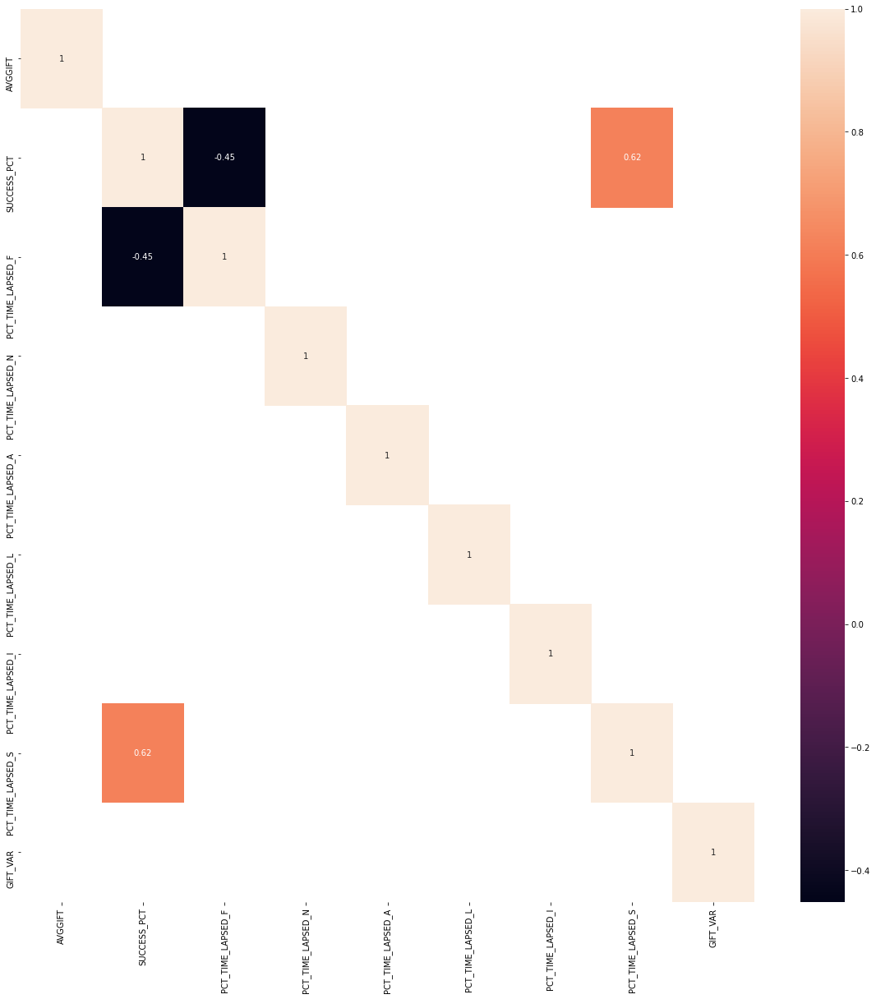

In [186]:
corr = filtered_df.corr()
corr = corr[np.abs(corr) > 0.45]


plt.figure(figsize=(20,20))
sns.heatmap(corr, annot=True)
plt.show()

## Analysing Interests columns

In [187]:
columns_interests= [
    'COLLECT1',
    'VETERANS',
    'BIBLE',
    'CATLG',
    'HOMEE',
    'PETS',
    'CDPLAY',
    'STEREO',
    'PCOWNERS',
    'PHOTO',
    'CRAFTS',
    'FISHER',
    'GARDENIN',
    'BOATS',
    'WALKER',
    'KIDSTUFF',
    'CARDS',
    'PLATES'
]

In [188]:
interests_df = df[columns_interests].copy()
interests_df.head()

,COLLECT1,VETERANS,BIBLE,CATLG,HOMEE,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,BOATS,WALKER,KIDSTUFF,CARDS,PLATES
0,,,,,,,,,,,,,,,,,,
1,,,,,,,,,,,,,,,,,,
2,,,,,,,,,,,,,,,,,,
3,,,,,,,,,,,,,,,,,,
4,,,Y,Y,,,,Y,,,Y,,Y,,Y,,Y,


In [189]:
interests_df = interests_df.applymap(lambda val: 1 if val == 'Y' else 0)
interests_df.head()

,COLLECT1,VETERANS,BIBLE,CATLG,HOMEE,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,BOATS,WALKER,KIDSTUFF,CARDS,PLATES
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,1,1,0,0,0,1,0,0,1,0,1,0,1,0,1,0


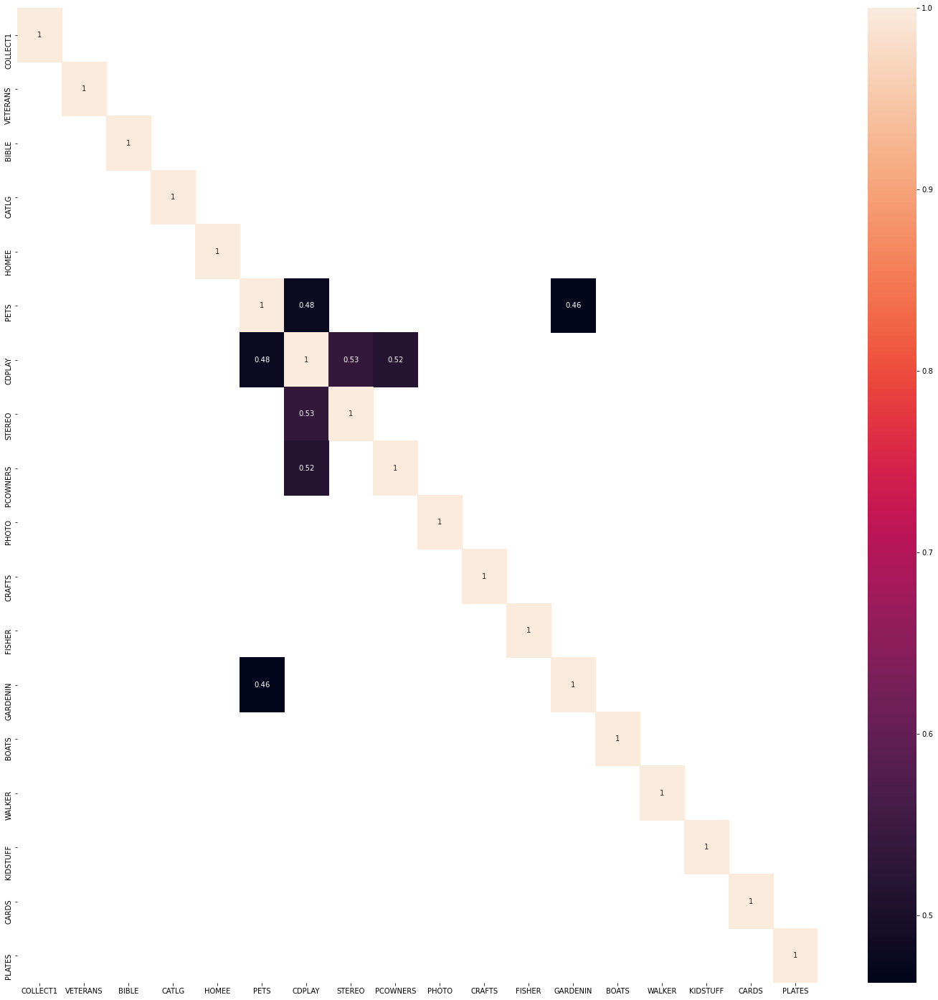

In [190]:
corr = interests_df.corr()
corr = corr[np.abs(corr) > 0.45]

plt.figure(figsize=(25,25))
sns.heatmap(corr, annot=True)
plt.show()

    low correlations, going to ignore for now since there's to many variables

## Analysing wealth columns

In [191]:
len(df)

95412

In [192]:
df['WEALTH1'].count(), df['WEALTH1'].isna().sum()

(50680, 44732)

In [193]:
df['WEALTH2'].count(), df['WEALTH2'].isna().sum()

(51589, 43823)

In [194]:
df.WEALTH1.max(), df.WEALTH1.min()

(9.0, 0.0)

In [195]:
df.WEALTH2.max(), df.WEALTH2.min()

(9.0, 0.0)

In [196]:
wealth_df = df[['WEALTH1','WEALTH2']].copy()

In [197]:
pct_non_NaN = wealth_df.mean(axis=1).count() / wealth_df.shape[0]
print('Percentage of columns with value after merge: %1.2f%%' % (pct_non_NaN *100))

Percentage of columns with value after merge: 77.11%


In [198]:
wealth_df['Merged'] = wealth_df.max(axis=1)
wealth_df.head()

,WEALTH1,WEALTH2,Merged
0,NaN,5.0,5.0
1,9.0,9.0,9.0
2,1.0,1.0,1.0
3,4.0,0.0,4.0
4,2.0,NaN,2.0


In [199]:
filtered_df['WEALTH'] = wealth_df.Merged
filtered_df.dropna(subset=['WEALTH'], inplace=True)
del wealth_df

filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S,GIFT_VAR,WEALTH
0,7.741935,0.418919,0.00000,0.000,0.000000,0.013514,0.000000,0.297297,0.619048,5.0
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000,0.000000,84.500000,9.0
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000,0.285714,2.571429,1.0
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000,0.227273,3.904762,4.0
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699,0.000000,12.500000,2.0


## Analysing other columns

In [200]:
other_df = df[['GENDER','INCOME','HOMEOWNR']].copy()
other_df.head()

,GENDER,INCOME,HOMEOWNR
0,F,NaN,
1,M,6.0,H
2,M,3.0,U
3,F,1.0,U
4,F,3.0,H


In [201]:
other_df.HOMEOWNR.replace(['',' '], 'U', inplace=True)
other_df.HOMEOWNR.replace(['U'], 0, inplace=True)
other_df.HOMEOWNR.replace(['H'], 1, inplace=True)

In [202]:
other_df.isna().sum()

GENDER          0
INCOME      21286
HOMEOWNR        0
dtype: int64

In [203]:
other_df.GENDER.replace(['A','C'],'J', inplace=True)
other_df.GENDER.replace(' ','U', inplace=True)
gender_dummies = pd.get_dummies(other_df.GENDER, prefix='GENDER')

In [204]:
other_df.drop(columns='GENDER', inplace=True)
other_df = other_df.join(gender_dummies)

In [205]:
filtered_df = pd.concat([filtered_df, other_df], axis=1)
filtered_df.dropna(subset=['INCOME'], inplace=True)
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S,GIFT_VAR,WEALTH,INCOME,HOMEOWNR,GENDER_F,GENDER_J,GENDER_M,GENDER_U
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000,0.000000,84.500000,9.0,6.0,1,0,0,1,0
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000,0.285714,2.571429,1.0,3.0,0,0,0,1,0
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000,0.227273,3.904762,4.0,1.0,0,1,0,0,0
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699,0.000000,12.500000,2.0,3.0,1,1,0,0,0
6,7.642857,0.222222,0.00000,0.000,0.126984,0.015873,0.000000,0.174603,0.500000,6.0,4.0,1,1,0,0,0


## Analysing Children columns

In [206]:
children_columns = [
    'CHILD03',
    'CHILD07',
    'CHILD12',
    'CHILD18',
    'NUMCHLD'
]

In [207]:
children_df = df[children_columns].copy()
children_df.head()

,CHILD03,CHILD07,CHILD12,CHILD18,NUMCHLD
0,,,,,NaN
1,,,,M,1.0
2,,,,,NaN
3,,,,,NaN
4,,,,,1.0


In [208]:
children_df.replace(' ', 0, inplace=True)
children_df.replace('', 0, inplace=True)
children_df.replace(['M','F','B'], 1, inplace=True)
children_df.fillna(0, inplace=True)

children_df = children_df.astype('int64')
children_df.head()

,CHILD03,CHILD07,CHILD12,CHILD18,NUMCHLD
0,0,0,0,0,0
1,0,0,0,1,1
2,0,0,0,0,0
3,0,0,0,0,0
4,0,0,0,0,1


In [209]:
children_df['SUM_ageGap_columns'] = children_df[children_columns[:-1]].sum(axis=1)
children_df.drop(columns=children_columns[:-1], inplace=True)

children_df.head()

,NUMCHLD,SUM_ageGap_columns
0,0,0
1,1,1
2,0,0
3,0,0
4,1,0


In [210]:
filtered_df['CHILDREN'] = children_df.max(axis=1)
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S,GIFT_VAR,WEALTH,INCOME,HOMEOWNR,GENDER_F,GENDER_J,GENDER_M,GENDER_U,CHILDREN
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000,0.000000,84.500000,9.0,6.0,1,0,0,1,0,1
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000,0.285714,2.571429,1.0,3.0,0,0,0,1,0,0
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000,0.227273,3.904762,4.0,1.0,0,1,0,0,0,0
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699,0.000000,12.500000,2.0,3.0,1,1,0,0,0,1
6,7.642857,0.222222,0.00000,0.000,0.126984,0.015873,0.000000,0.174603,0.500000,6.0,4.0,1,1,0,0,0,1


In [211]:
filtered_df.shape

(74126, 17)

## Adding Neighborhood Socio Economic Status

In [212]:
df['DOMAIN']

0        T2
1        S1
2        R2
3        R2
4        S2
         ..
95407    C2
95408    C1
95409    C3
95410    C1
95411    C1
Name: DOMAIN, Length: 95412, dtype: object

In [213]:
socio_economic_status = df['DOMAIN'].str[1]
socio_economic_status = pd.get_dummies(socio_economic_status, prefix='SES_')

socio_economic_status.head()

,SES__1,SES__2,SES__3,SES__4
0,0,1,0,0
1,1,0,0,0
2,0,1,0,0
3,0,1,0,0
4,0,1,0,0


In [214]:
filtered_df = filtered_df.join(socio_economic_status, how='left')
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S,GIFT_VAR,WEALTH,INCOME,HOMEOWNR,GENDER_F,GENDER_J,GENDER_M,GENDER_U,CHILDREN,SES__1,SES__2,SES__3,SES__4
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000,0.000000,84.500000,9.0,6.0,1,0,0,1,0,1,1,0,0,0
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000,0.285714,2.571429,1.0,3.0,0,0,0,1,0,0,0,1,0,0
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000,0.227273,3.904762,4.0,1.0,0,1,0,0,0,0,0,1,0,0
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699,0.000000,12.500000,2.0,3.0,1,1,0,0,0,1,0,1,0,0
6,7.642857,0.222222,0.00000,0.000,0.126984,0.015873,0.000000,0.174603,0.500000,6.0,4.0,1,1,0,0,0,1,0,1,0,0


In [215]:
filtered_df.dropna(inplace=True)

In [216]:
filtered_df.shape

(62718, 21)

## Normalizing data

In [217]:
from sklearn.preprocessing import StandardScaler

In [218]:
#scaler = StandardScaler()
#scaler.fit(filtered_df)
#filtered_df[filtered_df.columns] = pd.DataFrame(scaler.transform(filtered_df))

In [219]:
filtered_df.dropna(inplace=True)

In [220]:
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S,GIFT_VAR,WEALTH,INCOME,HOMEOWNR,GENDER_F,GENDER_J,GENDER_M,GENDER_U,CHILDREN,SES__1,SES__2,SES__3,SES__4
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000,0.000000,84.500000,9.0,6.0,1,0,0,1,0,1,1,0,0,0
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000,0.285714,2.571429,1.0,3.0,0,0,0,1,0,0,0,1,0,0
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000,0.227273,3.904762,4.0,1.0,0,1,0,0,0,0,0,1,0,0
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699,0.000000,12.500000,2.0,3.0,1,1,0,0,0,1,0,1,0,0
6,7.642857,0.222222,0.00000,0.000,0.126984,0.015873,0.000000,0.174603,0.500000,6.0,4.0,1,1,0,0,0,1,0,1,0,0


## Correlation check

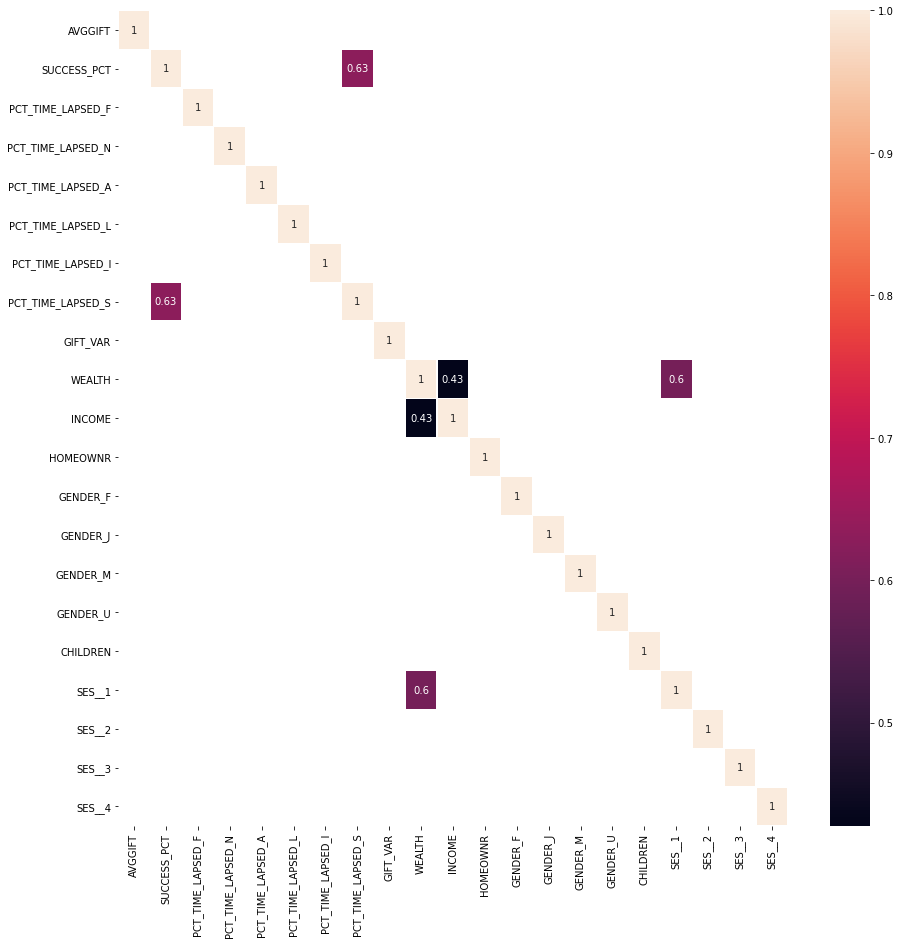

In [221]:
corr = filtered_df.corr()
corr = corr[corr > 0.4]

plt.figure(figsize=(15,15))
sns.heatmap(corr, annot=True, linewidths=0.2)
plt.show()

    overall looking ok

# Clustering

In [222]:
from sklearn.cluster import KMeans
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import Birch

In [223]:
inertia = []
k_range = range(1,15)

In [224]:
for k in k_range:
    k_means = KMeans(n_clusters=k)
    k_means.fit(filtered_df)
    inertia.append(k_means.inertia_)

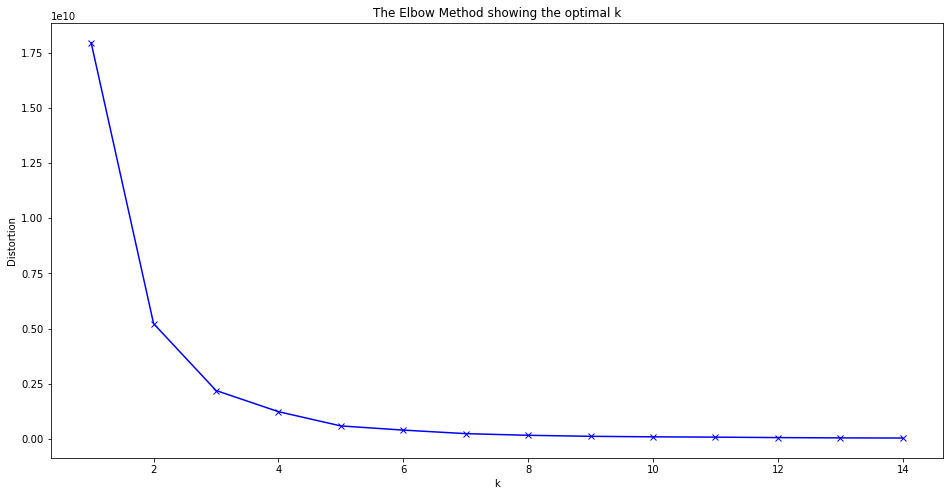

In [225]:
plt.figure(figsize=(16,8))
plt.plot(k_range, inertia, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [226]:
from sklearn.feature_selection import VarianceThreshold

k_means = KMeans(n_clusters=3)
k_means.fit(filtered_df)

new_column = 'cluster'

selector = VarianceThreshold()

filtered_df[new_column] = k_means.predict(selector.fit_transform(filtered_df))


selector

VarianceThreshold()

In [227]:
selector.get_support()

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True])

In [228]:
filtered_df.head()

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S,GIFT_VAR,WEALTH,INCOME,HOMEOWNR,GENDER_F,GENDER_J,GENDER_M,GENDER_U,CHILDREN,SES__1,SES__2,SES__3,SES__4,cluster
1,15.666667,0.093750,0.03125,0.125,0.312500,0.062500,0.000000,0.000000,84.500000,9.0,6.0,1,0,0,1,0,1,1,0,0,0,0
2,7.481481,0.428571,0.00000,0.000,0.000000,0.015873,0.000000,0.285714,2.571429,1.0,3.0,0,0,0,1,0,0,0,1,0,0,0
3,6.812500,0.242424,0.00000,0.000,0.060606,0.015152,0.000000,0.227273,3.904762,4.0,1.0,0,1,0,0,0,0,0,1,0,0,0
4,6.864865,0.327434,0.00000,0.000,0.132743,0.044248,0.017699,0.000000,12.500000,2.0,3.0,1,1,0,0,0,1,0,1,0,0,0
6,7.642857,0.222222,0.00000,0.000,0.126984,0.015873,0.000000,0.174603,0.500000,6.0,4.0,1,1,0,0,0,1,0,1,0,0,0


In [229]:
filtered_df.groupby(new_column).mean().transpose()

cluster,0,1,2
AVGGIFT,12.918108,69.111111,109.901845
SUCCESS_PCT,0.184436,0.125000,0.156718
PCT_TIME_LAPSED_F,0.041330,0.000000,0.032724
PCT_TIME_LAPSED_N,0.047906,0.000000,0.039093
PCT_TIME_LAPSED_A,0.179875,0.305556,0.136137
PCT_TIME_LAPSED_L,0.048068,0.013889,0.040144
PCT_TIME_LAPSED_I,0.002590,0.000000,0.000000
PCT_TIME_LAPSED_S,0.066078,0.000000,0.041606
GIFT_VAR,20.061883,112812.500000,18369.675926
WEALTH,5.317121,7.000000,6.444444


In [230]:
pctimes = ['PCT_TIME_LAPSED_F', 'PCT_TIME_LAPSED_N', 'PCT_TIME_LAPSED_L', 'PCT_TIME_LAPSED_S', 'PCT_TIME_LAPSED_A', 'PCT_TIME_LAPSED_I']
target =  ['AVGGIFT', 'SUCCESS_PCT']
total = pctimes+target

In [231]:
model = KMeans(n_clusters=3)

new_column = 'cluster_affinity'

#selector = VarianceThreshold()

filtered_df[new_column] = model.fit_predict(filtered_df[total])


#filtered_df[new_column] = model.fit_predict(selector.fit_transform(filtered_df.iloc[:,:-1]))


selector.get_support()

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True])

In [232]:
filtered_df['cluster_affinity'].value_counts()

0    49692
1    12801
2      225
Name: cluster_affinity, dtype: int64

In [234]:
filtered_df.iloc[:,:-2]

,AVGGIFT,SUCCESS_PCT,PCT_TIME_LAPSED_F,PCT_TIME_LAPSED_N,PCT_TIME_LAPSED_A,PCT_TIME_LAPSED_L,PCT_TIME_LAPSED_I,PCT_TIME_LAPSED_S,GIFT_VAR,WEALTH,INCOME,HOMEOWNR,GENDER_F,GENDER_J,GENDER_M,GENDER_U,CHILDREN,SES__1,SES__2,SES__3,SES__4
1,15.666667,0.093750,0.03125,0.125000,0.312500,0.062500,0.000000,0.000000,84.500000,9.0,6.0,1,0,0,1,0,1,1,0,0,0
2,7.481481,0.428571,0.00000,0.000000,0.000000,0.015873,0.000000,0.285714,2.571429,1.0,3.0,0,0,0,1,0,0,0,1,0,0
3,6.812500,0.242424,0.00000,0.000000,0.060606,0.015152,0.000000,0.227273,3.904762,4.0,1.0,0,1,0,0,0,0,0,1,0,0
4,6.864865,0.327434,0.00000,0.000000,0.132743,0.044248,0.017699,0.000000,12.500000,2.0,3.0,1,1,0,0,0,1,0,1,0,0
6,7.642857,0.222222,0.00000,0.000000,0.126984,0.015873,0.000000,0.174603,0.500000,6.0,4.0,1,1,0,0,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95404,5.900000,0.263158,0.00000,0.131579,0.000000,0.026316,0.000000,0.421053,5.142857,3.0,1.0,1,1,0,0,0,1,0,1,0,0
95406,3.375000,0.406780,0.00000,0.000000,0.000000,0.016949,0.000000,0.288136,1.300000,6.0,6.0,1,1,0,0,0,0,0,1,0,0
95408,20.000000,0.100000,0.00000,0.000000,0.000000,0.100000,0.000000,0.000000,0.000000,9.0,7.0,1,0,0,1,0,1,1,0,0,0
95410,12.146341,0.322835,0.00000,0.000000,0.039370,0.007874,0.000000,0.133858,4.027778,7.0,7.0,1,1,0,0,0,0,1,0,0,0


In [236]:
filtered_df.isna().sum()

AVGGIFT              0
SUCCESS_PCT          0
PCT_TIME_LAPSED_F    0
PCT_TIME_LAPSED_N    0
PCT_TIME_LAPSED_A    0
PCT_TIME_LAPSED_L    0
PCT_TIME_LAPSED_I    0
PCT_TIME_LAPSED_S    0
GIFT_VAR             0
WEALTH               0
INCOME               0
HOMEOWNR             0
GENDER_F             0
GENDER_J             0
GENDER_M             0
GENDER_U             0
CHILDREN             0
SES__1               0
SES__2               0
SES__3               0
SES__4               0
cluster              0
cluster_affinity     0
dtype: int64

In [235]:
from sklearn.manifold import TSNE

X = filtered_df.iloc[:,:-2]

X_embedded = TSNE(n_components=2).fit_transform(X)

#

C:\Users\josem\.conda\envs\python-standard\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


ValueError: If using all scalar values, you must pass an index

In [237]:
X_embedded

array([[-41.34929 ,  46.133034],
       [ 31.626215,  23.887804],
       [ 21.90789 , -20.000977],
       ...,
       [ 30.537014, -40.466114],
       [-20.82663 , -12.280539],
       [-21.400812, -60.160122]], dtype=float32)

C:\Users\josem\.conda\envs\python-standard\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:>

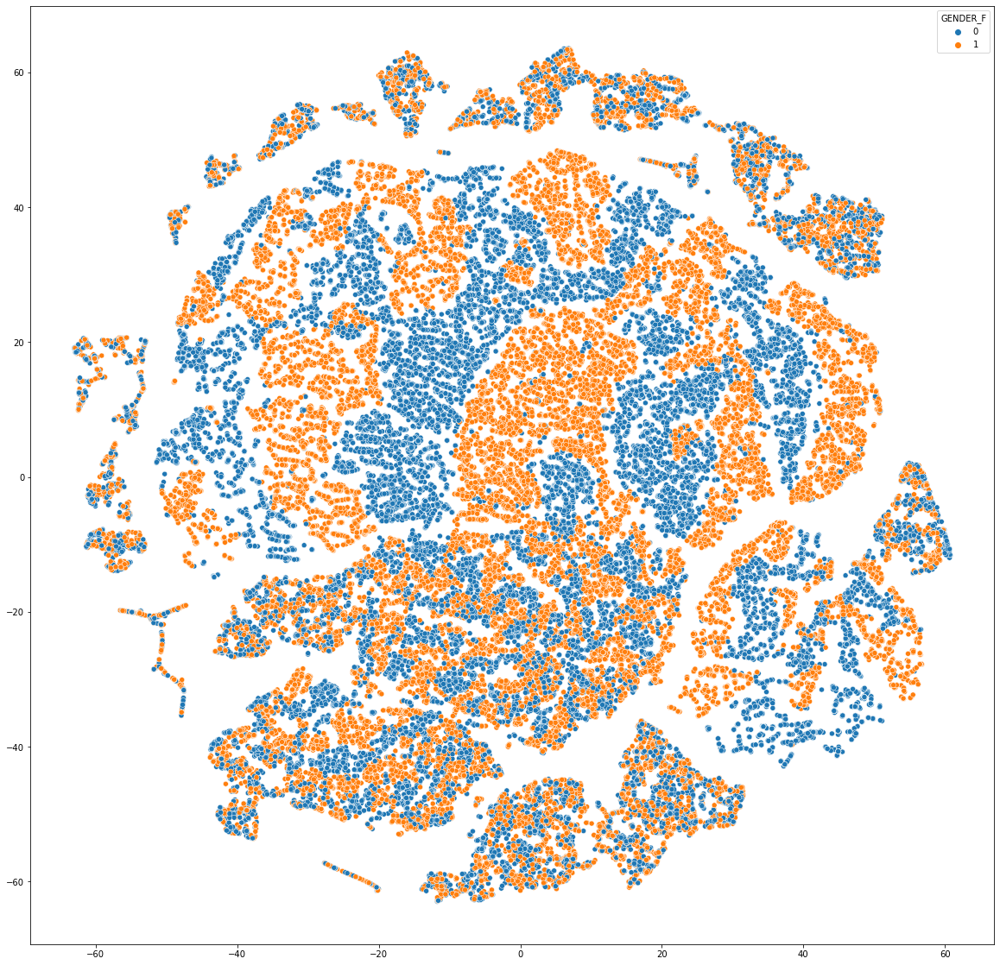

In [244]:
x = X_embedded[:,0]
y =X_embedded[:,1]
plt.figure(figsize=(20,20))
sns.scatterplot(x,y, hue = filtered_df['GENDER_F'], )

C:\Users\josem\.conda\envs\python-standard\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\josem\.conda\envs\python-standard\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\josem\.conda\envs\python-standard\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misi

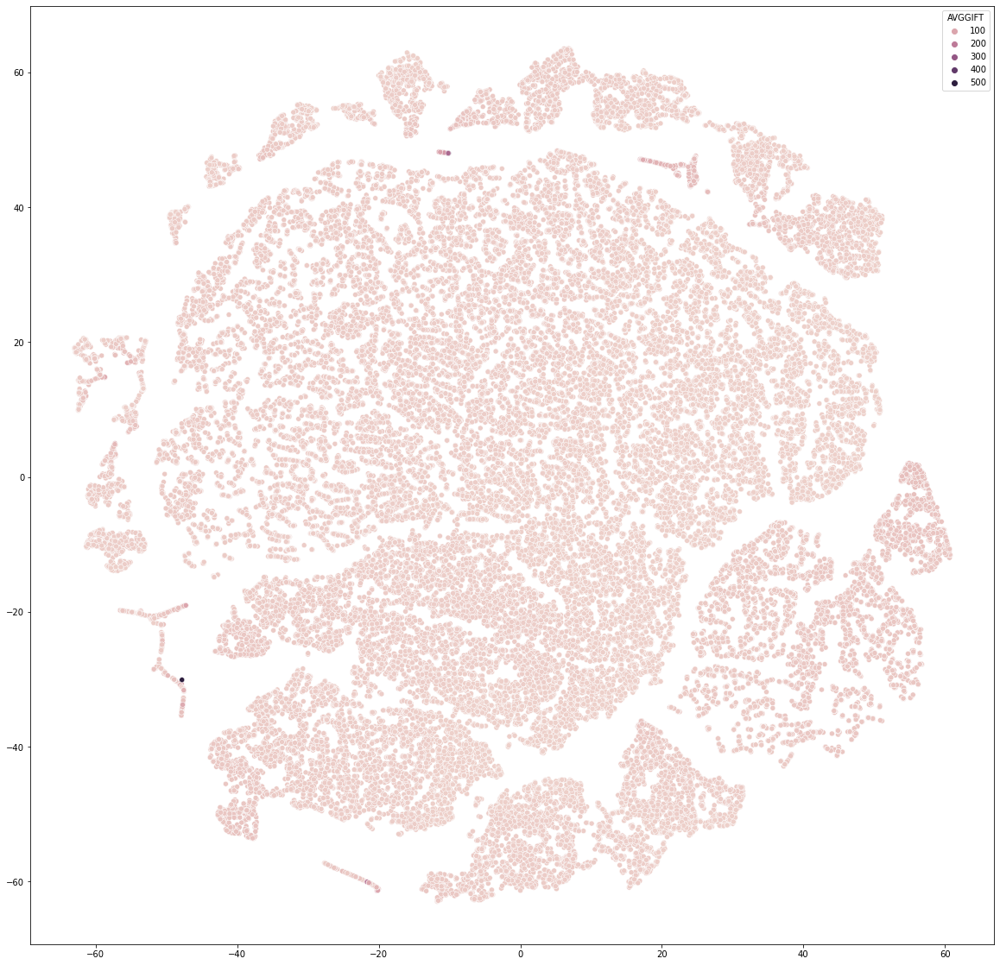

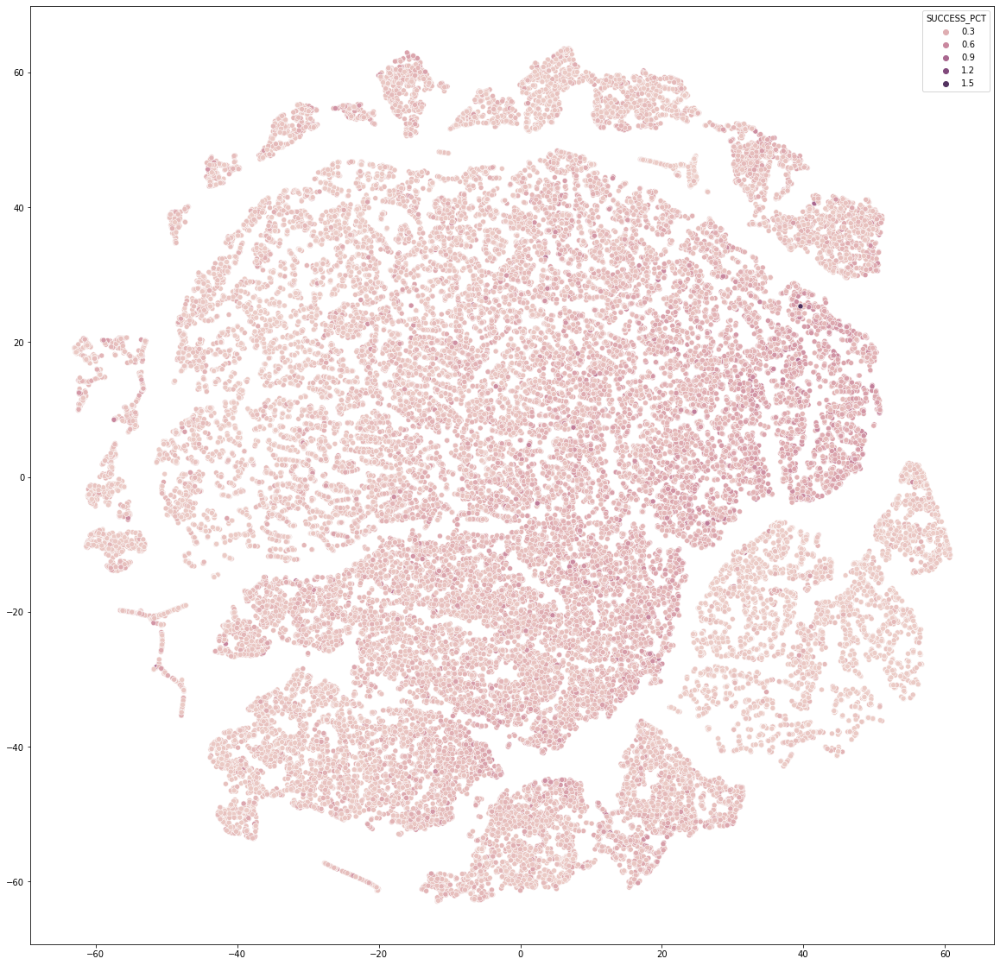

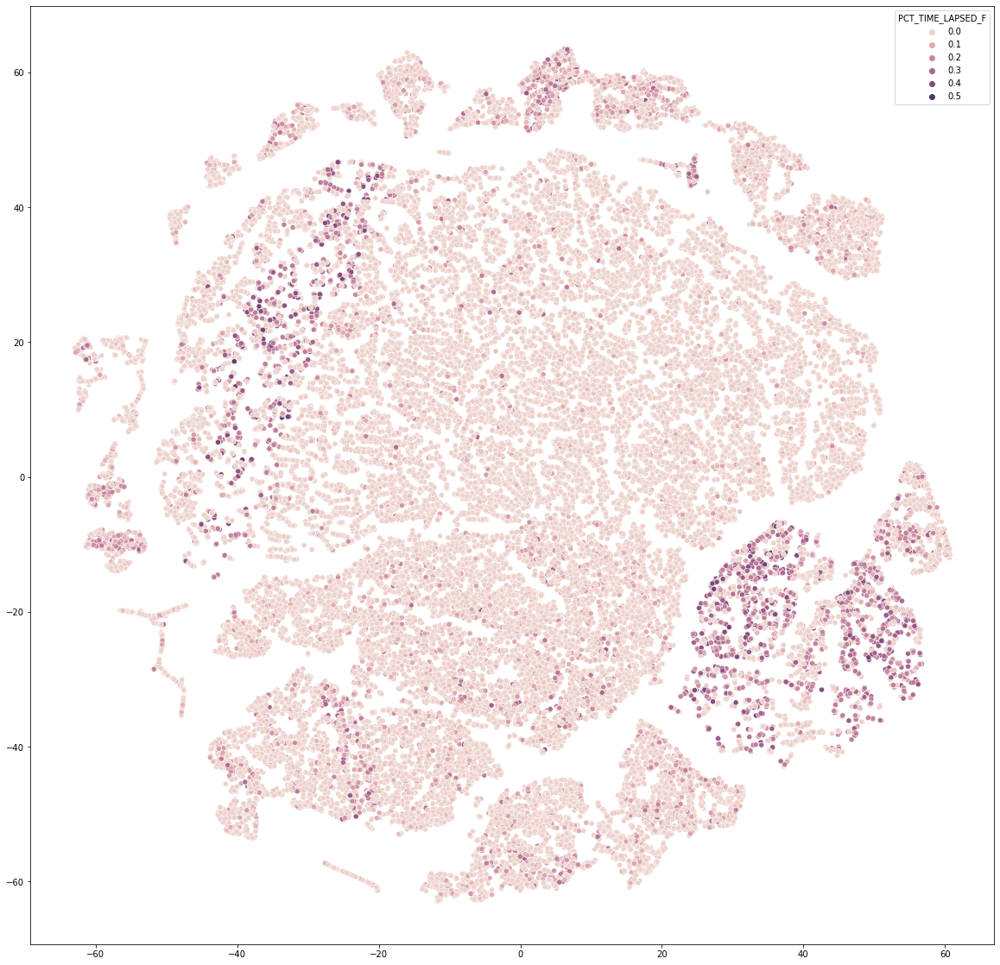

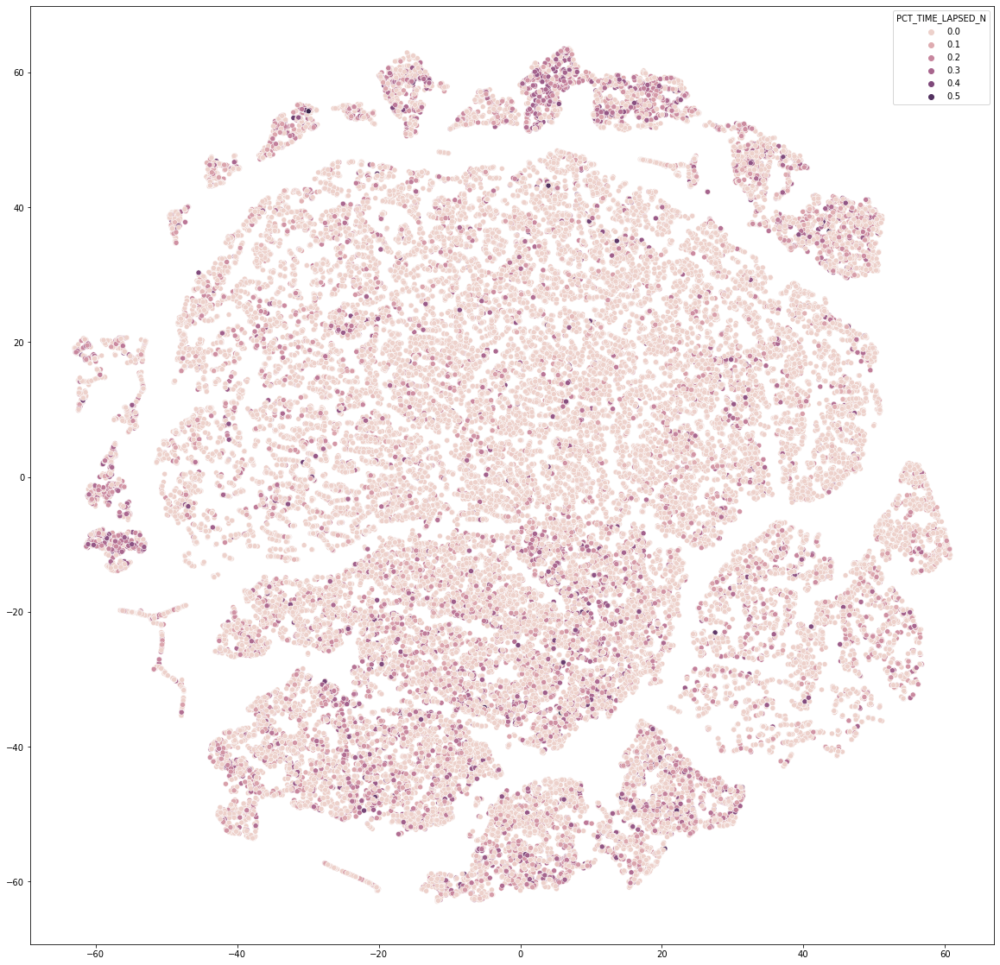

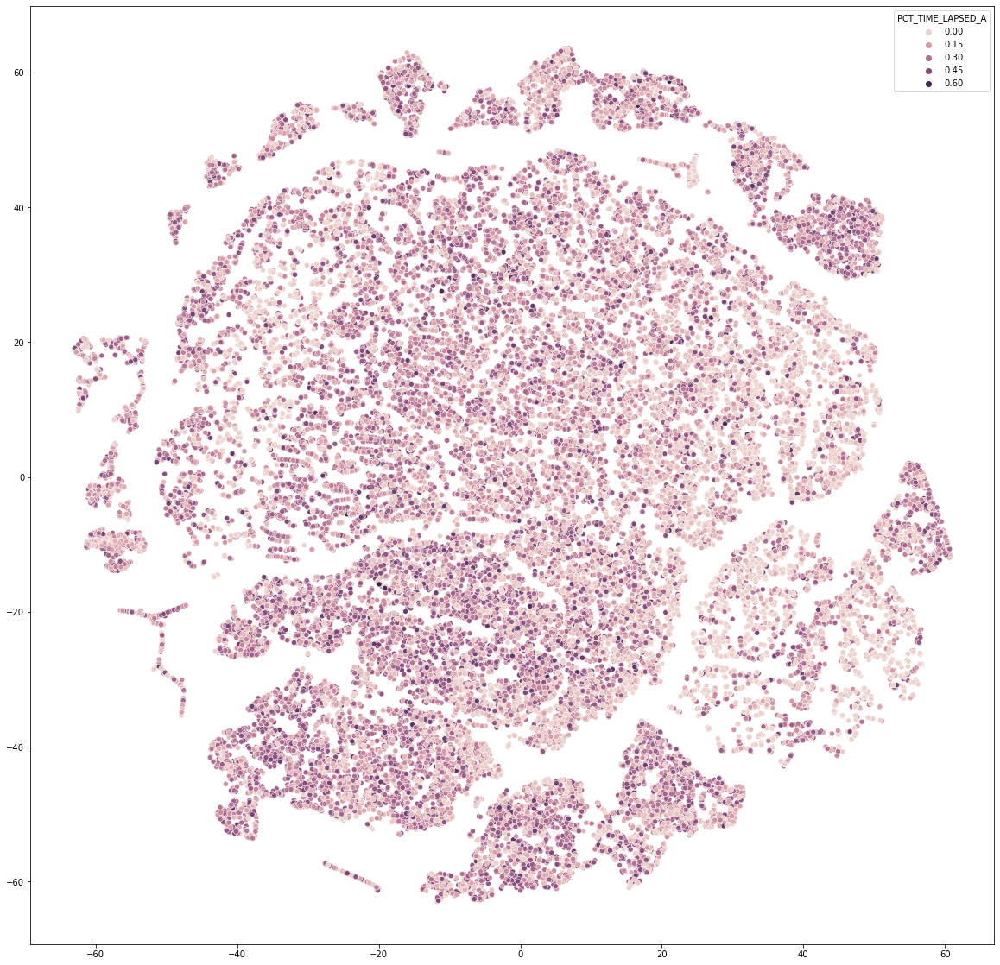

...

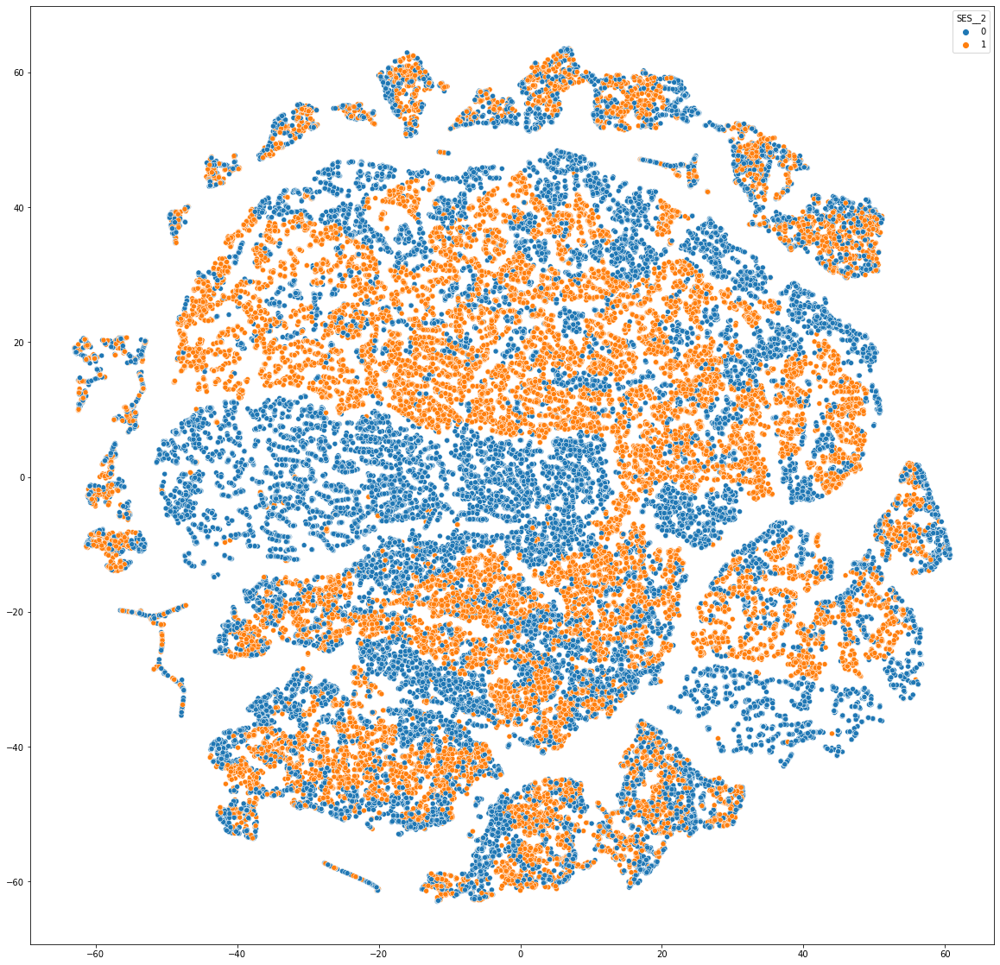

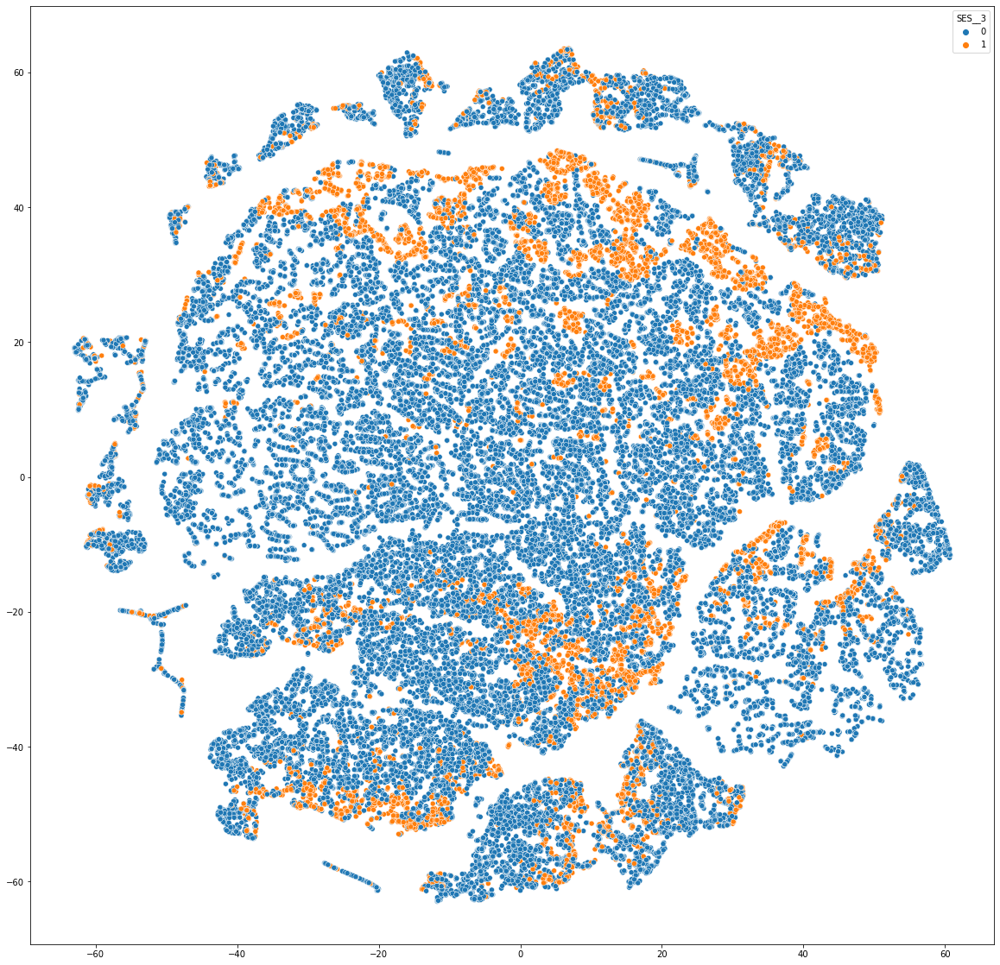

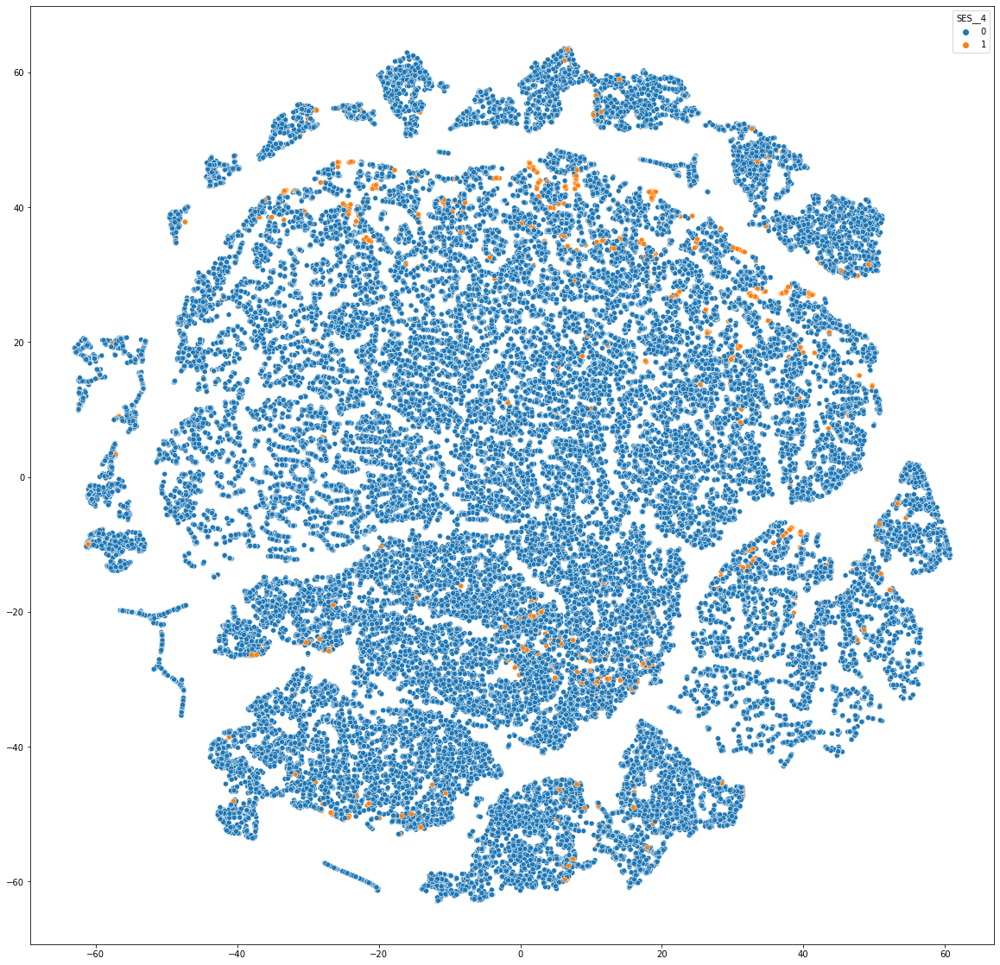

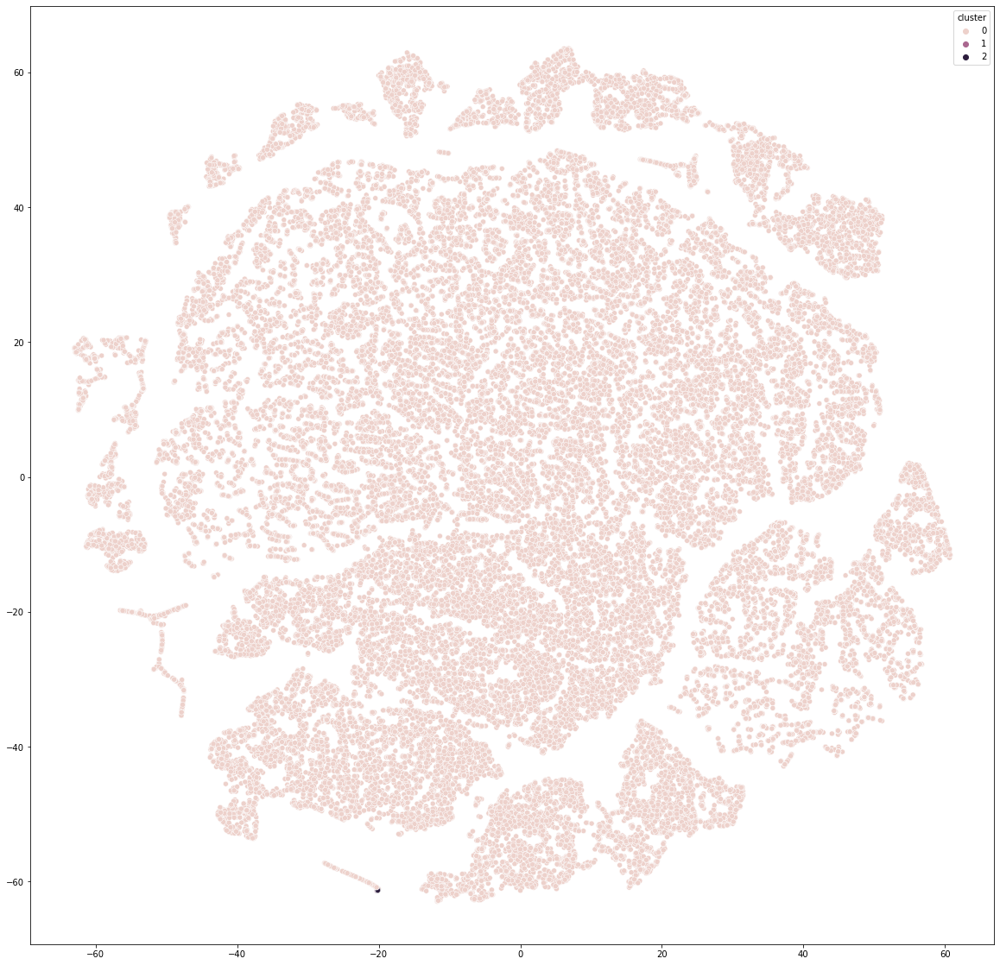

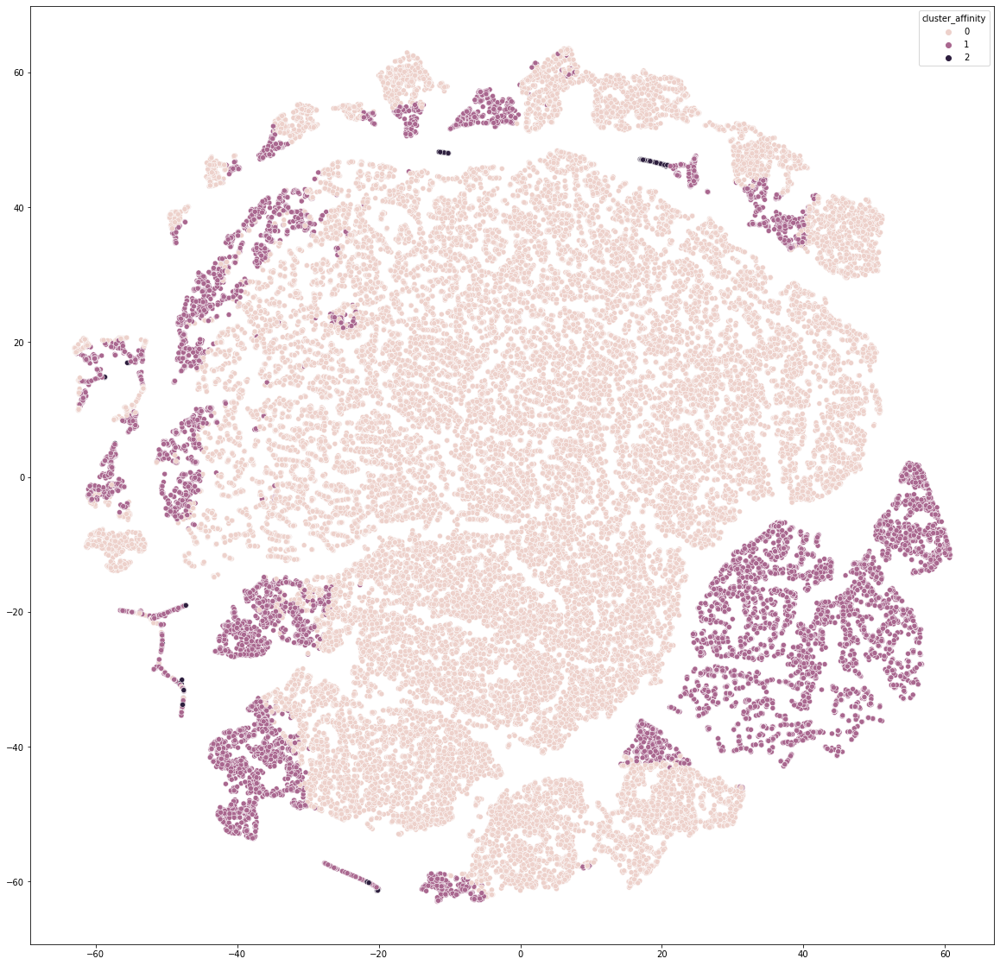

In [246]:
for column in filtered_df.columns: 
    plt.figure(figsize=(20,20))
    sns.scatterplot(x,y, hue = filtered_df[column])
    plt.savefig('Images/%s_TSNE.png' % column)

In [158]:
len(pd.Series(model.labels_).unique())

3

In [159]:
figure = boxplot_cluster_compparisson(filtered_df)

In [160]:
figure.savefig('Images/pretty_boxplot.png')